# **Albumentations Augmentation Examples**

Use the images from [here](https://github.com/tim3in/cv-examples/tree/main/albumentations_example_images) for examples in this notebook.

In [1]:
!pip install -U albumentations --quiet

In [2]:
import cv2, albumentations as A
import matplotlib.pyplot as plt
import numpy as np
import nibabel as nib

img = cv2.imread("raccoon.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Pixel-level augmentation


## Blur

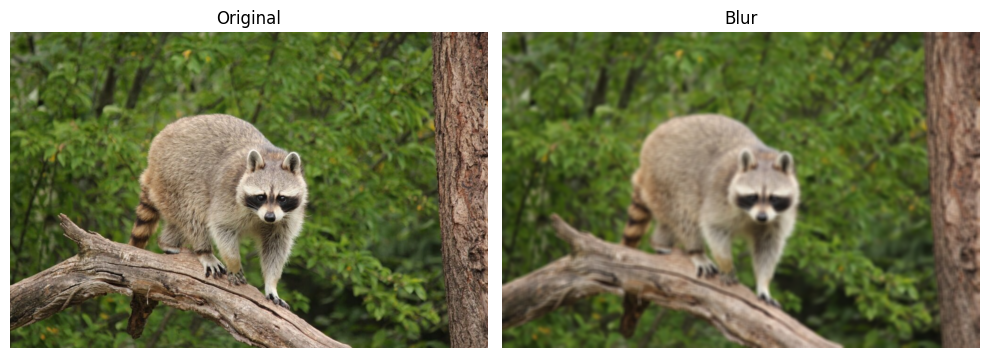

In [ ]:
transform = A.Blur(
    blur_limit=(7, 13), # optional. Use larger kernel for stronger blur
    p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Blur"); plt.axis("off")
plt.tight_layout(); plt.show()

## ChannelShuffle

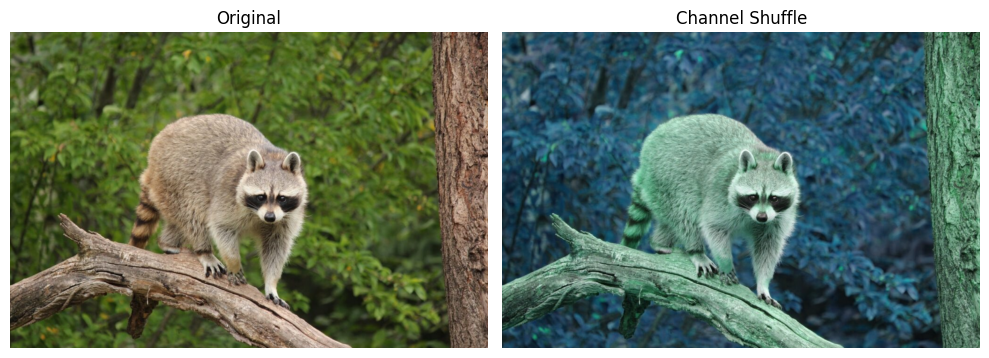

In [ ]:
transform = A.ChannelShuffle(p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Channel Shuffle"); plt.axis("off")
plt.tight_layout(); plt.show()

## CLAHE

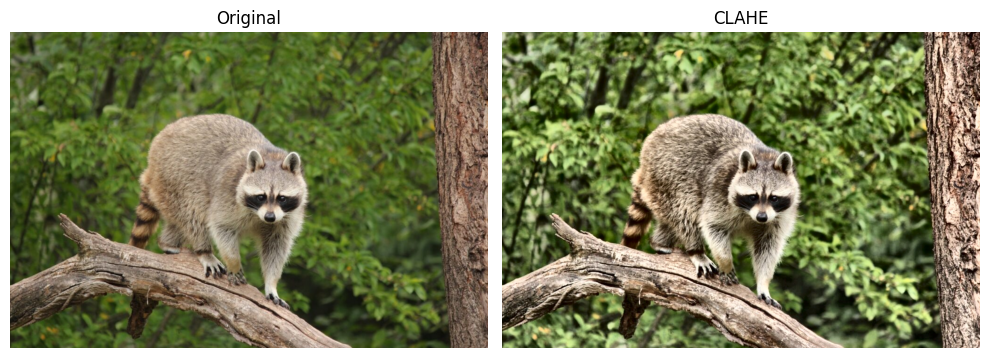

In [ ]:
transform = A.CLAHE(
        clip_limit=4.0, # Single value or range [1, clip_limit] to control the contrast enhancement.
        tile_grid_size=(8, 8), # number of tiles in the row and column directions.
        p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("CLAHE"); plt.axis("off")
plt.tight_layout(); plt.show()

## GaussianBlur

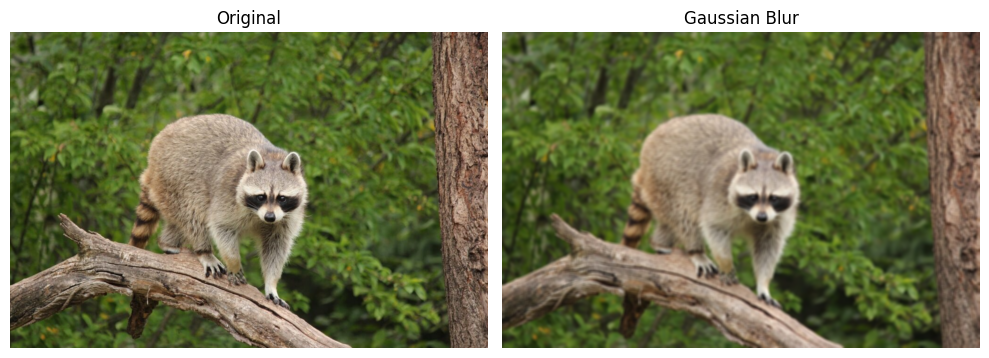

In [ ]:
transform = A.GaussianBlur(
    sigma_limit=(3.0, 7.0),  # Small sigma eg. (0.2, 0.5) for subtle blur larger (3.0, 7.0) for stronger blur
    blur_limit=(9, 9),       # nxn for fixed kernel size, 0 for auto-compute kernel size
    p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gaussian Blur"); plt.axis("off")
plt.tight_layout(); plt.show()

## GaussNoise

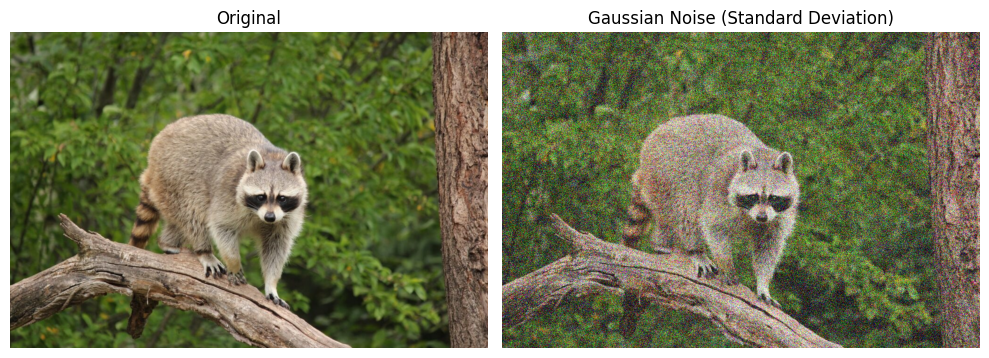

In [ ]:
transform = A.GaussNoise(
    std_range=(0.3, 0.6), # range between [0, 1] for noise standard deviation as a fraction
    p=1.0
    )
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gaussian Noise (Standard Deviation)"); plt.axis("off")
plt.tight_layout(); plt.show()

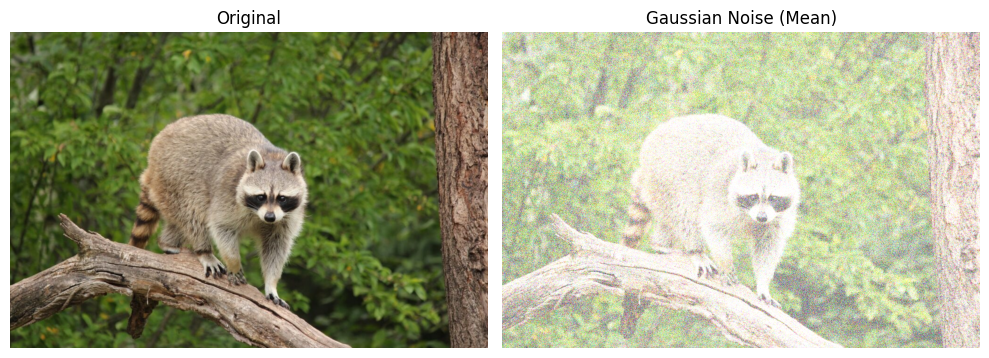

In [ ]:
transform = A.GaussNoise(
    mean_range=(0.3, 0.6), # range between [0, 1] for noise mean as a fraction
    p=1.0
    )
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gaussian Noise (Mean)"); plt.axis("off")
plt.tight_layout(); plt.show()

## HueSaturationValue

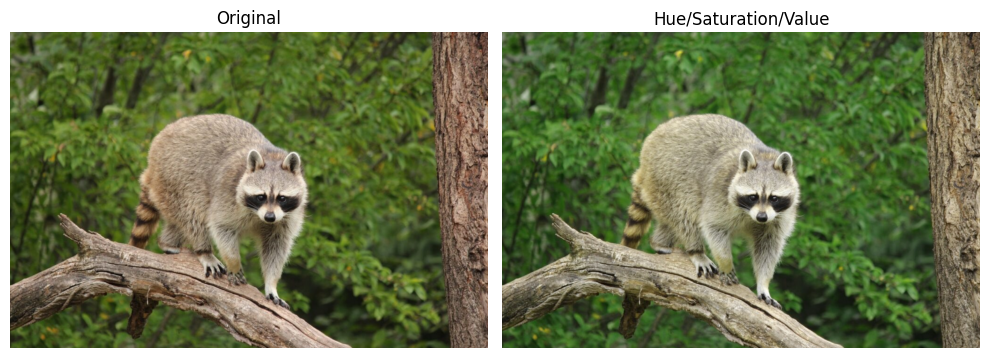

In [ ]:
transform = A.HueSaturationValue(
    hue_shift_limit=20, # single value or renge between [-180, 180] to change Hue
    sat_shift_limit=30, # single value or renge between [-255, 255] to change Saturation
    val_shift_limit=20, # single value or renge between [-255, 255] to change Brightness
    p=1.0 # Probability of applying the transform.
    )
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Hue/Saturation/Value"); plt.axis("off")
plt.tight_layout(); plt.show()

## Normalize

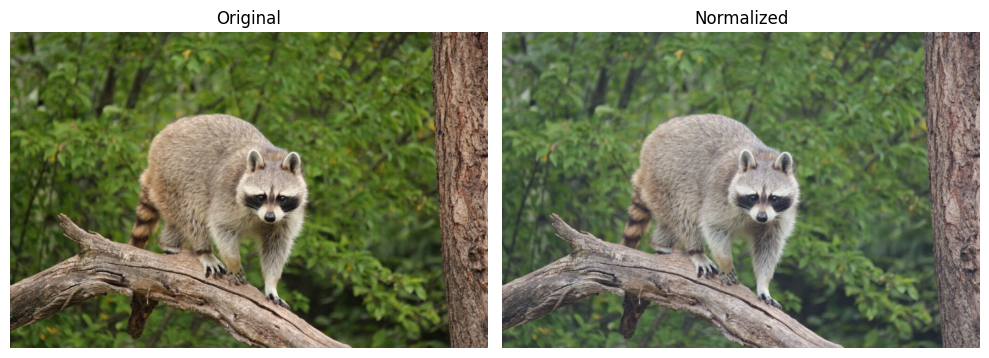

In [ ]:
transform = A.Normalize(
    mean=(0.485, 0.456, 0.406),
    std=(0.229, 0.224, 0.225),
    max_pixel_value=255.0,
    p=1.0)

aug = transform(image=img)["image"]

# Convert for display
aug_display = ((aug * 0.2 + 0.5) * 255).clip(0, 255).astype(np.uint8)

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug_display); plt.title("Normalized"); plt.axis("off")
plt.tight_layout(); plt.show()

## RandomBrightnessContrast

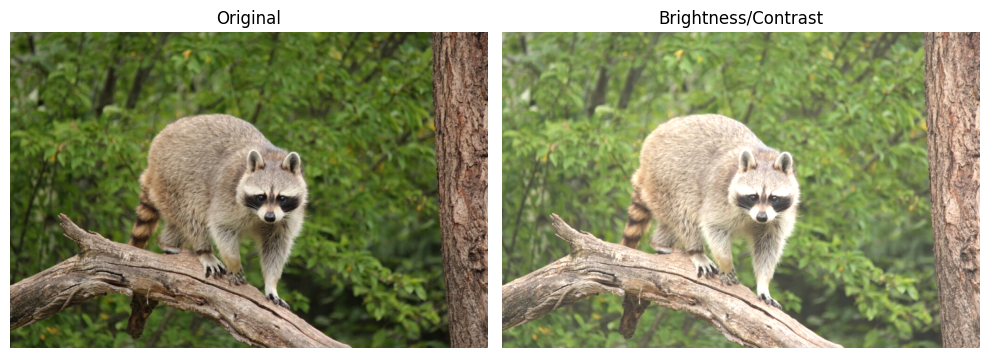

In [ ]:
transform = A.RandomBrightnessContrast(
    brightness_limit=0.3, # Factor for changing brightness, single value or range [-1.0, 1.0]
    contrast_limit=0.3, # Factor for changing contrast, single value or range [-1.0, 1.0]
    p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Brightness/Contrast"); plt.axis("off")
plt.tight_layout(); plt.show()

## Sharpen

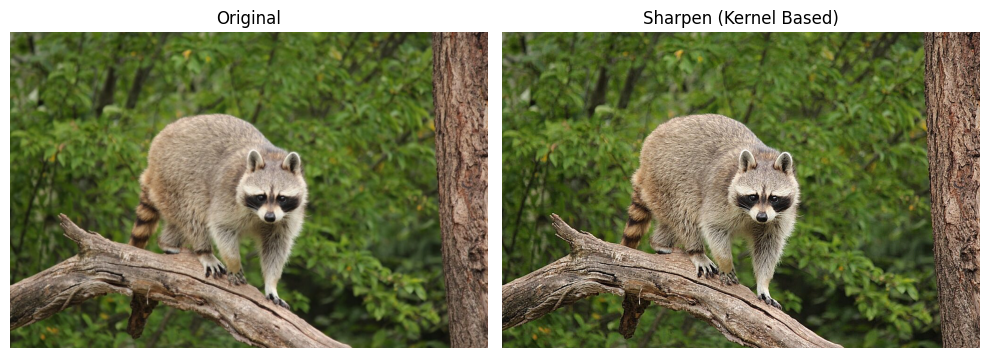

In [ ]:
transform = A.Sharpen(alpha=(0.2, 0.5),
          lightness=(0.8, 1.0),
          method='kernel',
          p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Sharpen (Kernel Based)"); plt.axis("off")
plt.tight_layout(); plt.show()

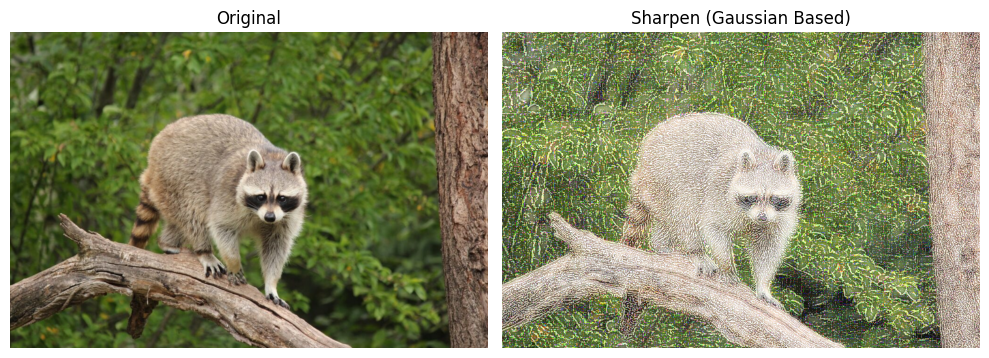

In [ ]:
transform = A.Sharpen(alpha=(0.5, 1.0),
        method='gaussian',
        kernel_size=5,
        sigma=1.0,
        p=1.0)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Sharpen (Gaussian Based)"); plt.axis("off")
plt.tight_layout(); plt.show()

## ToGray

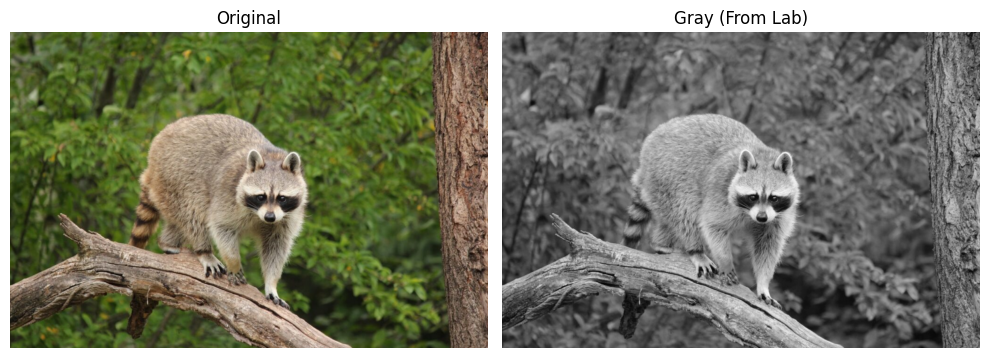

In [ ]:
transform = A.ToGray(
        method="from_lab", # method used for grayscale conversion
        p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gray (From Lab)"); plt.axis("off")
plt.tight_layout(); plt.show()

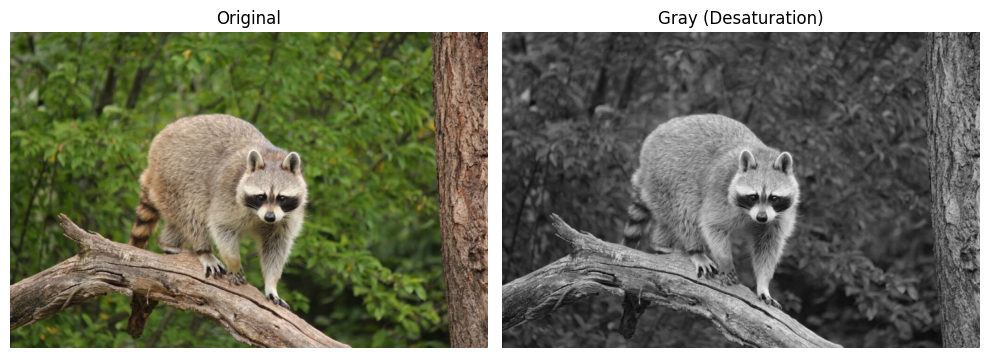

In [ ]:
transform = A.ToGray(
        method="desaturation", # method used for grayscale conversion
        p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gray (Desaturation)"); plt.axis("off")
plt.tight_layout(); plt.show()

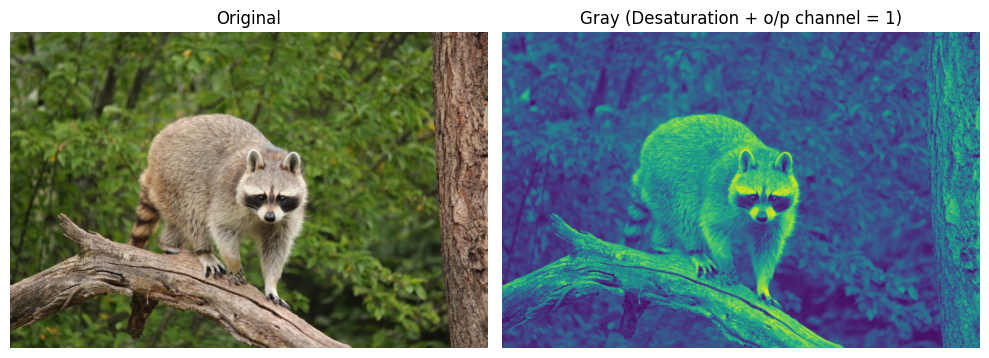

In [ ]:
transform = A.ToGray(
        method="desaturation", # method used for grayscale conversion
        num_output_channels=1, # number of output channels. Default is 3
        p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Gray (Desaturation + o/p channel = 1)"); plt.axis("off")
plt.tight_layout(); plt.show()

# Spatial-level transforms

## Affine

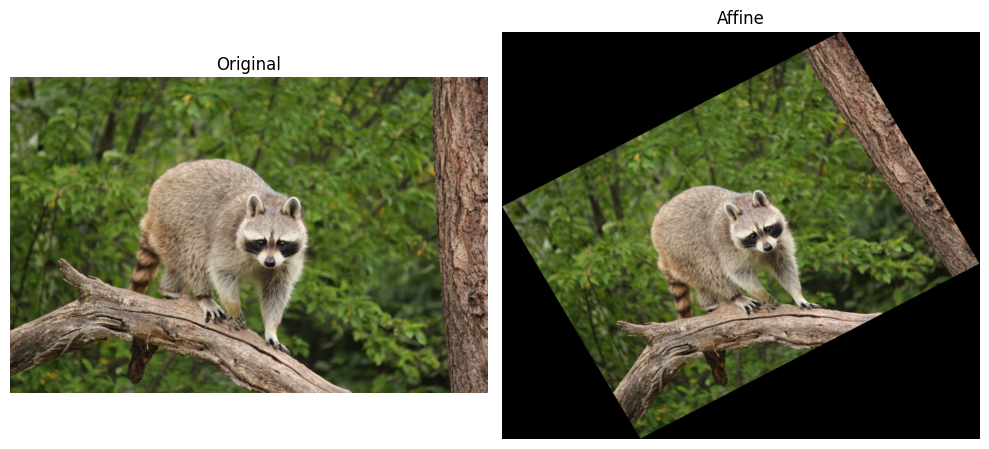

In [ ]:
transform = A.Affine(
    scale=(0.8, 1.2),
    rotate=(-30, 30),
    shear={"x": (-10, 10), "y": (-5, 5)},
    translate_percent={"x": (-0.1, 0.1), "y": (-0.1, 0.1)},
    interpolation=1,  # cv2.INTER_LINEAR
    fit_output=True,
    fill=0,
    p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Affine"); plt.axis("off")
plt.tight_layout(); plt.show()

## Crop

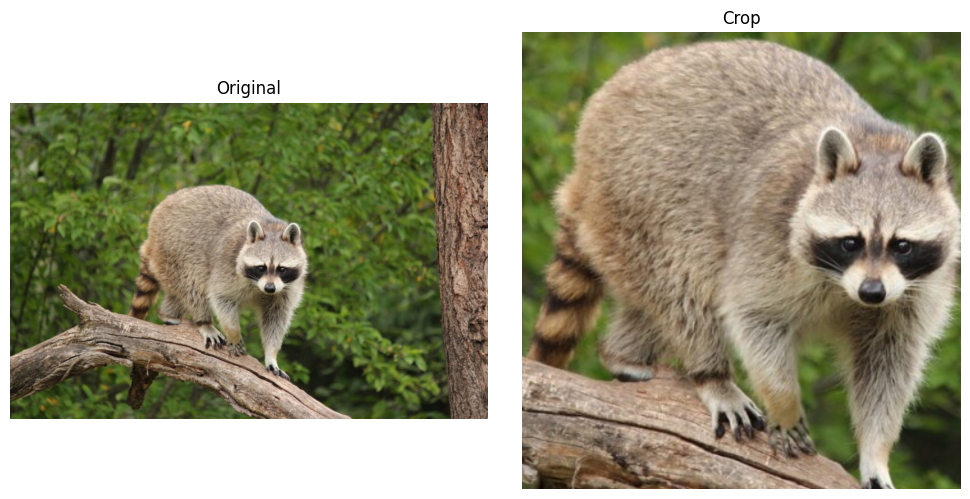

In [ ]:
transform = A.Crop(
    x_min=310,
    y_min=210,
    x_max=790,
    y_max=710,
    pad_if_needed=False,
    pad_position="center",
    border_mode=cv2.BORDER_CONSTANT,
    fill=0,
    fill_mask=0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Crop"); plt.axis("off")
plt.tight_layout(); plt.show()

## Horizontal Flip

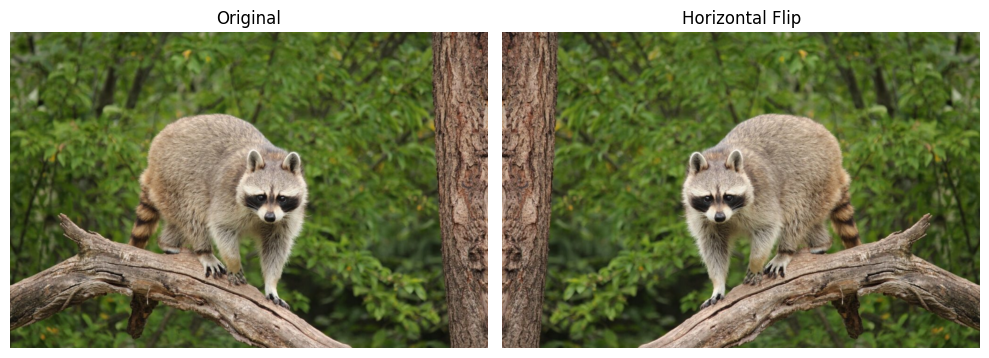

In [ ]:
transform = A.HorizontalFlip(
    p=1.0 # Always apply for this example
    )
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Horizontal Flip"); plt.axis("off")
plt.tight_layout(); plt.show()

## Vertical Flip

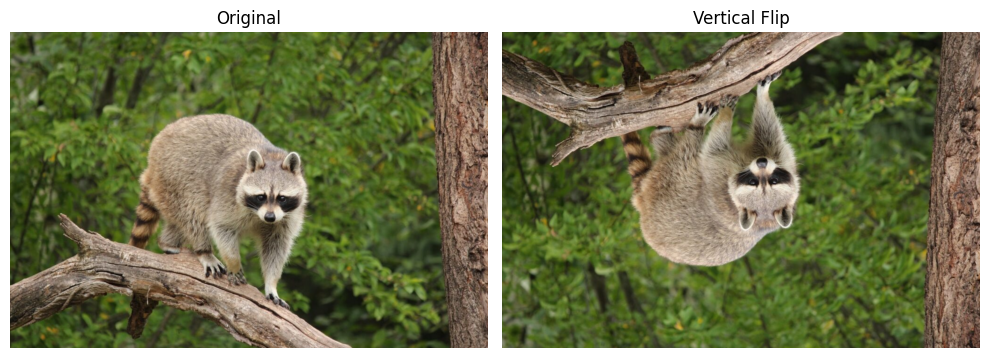

In [ ]:
transform = A.VerticalFlip(
    p=1.0 # Always apply for this example
    )
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Vertical Flip"); plt.axis("off")
plt.tight_layout(); plt.show()

## Rotate

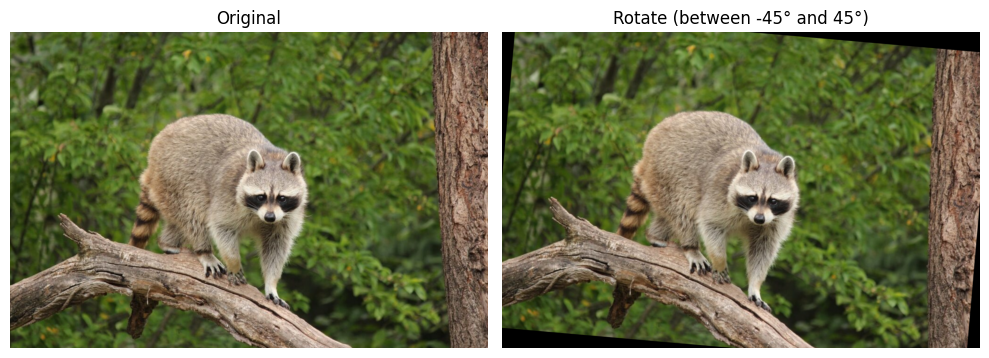

In [ ]:
transform = A.Rotate(
    limit=45,                   # rotate randomly between -45° and 45°
    interpolation=1,            # cv2.INTER_LINEAR
    border_mode=0,              # cv2.BORDER_CONSTANT
    fill=0,                     # fill empty space with black
    p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Rotate (between -45° and 45°)"); plt.axis("off")
plt.tight_layout(); plt.show()

## Resize

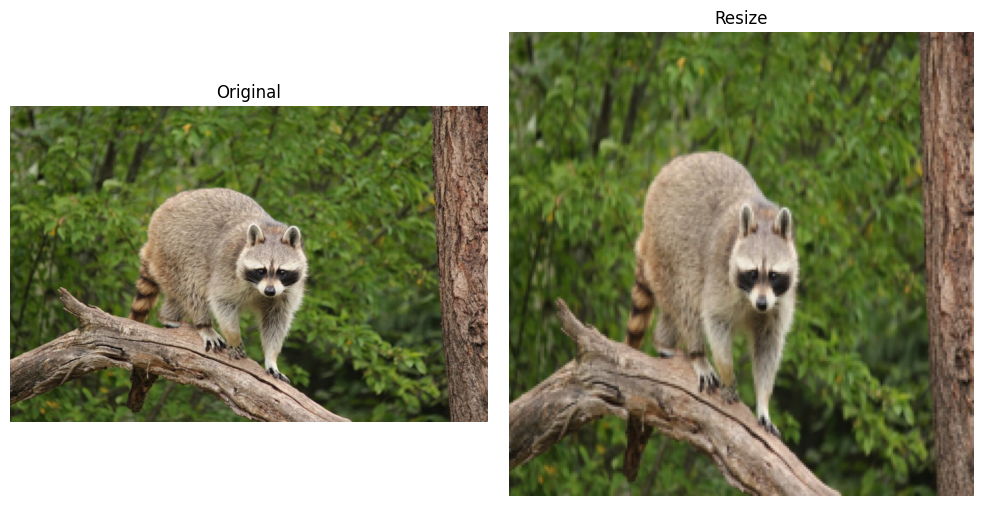

In [ ]:
transform = A.Resize(
    height=224,
    width=224,
    interpolation=cv2.INTER_LINEAR,
    mask_interpolation=cv2.INTER_NEAREST,
    area_for_downscale="image",
    p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Resize"); plt.axis("off")
plt.tight_layout(); plt.show()

## Random Scale

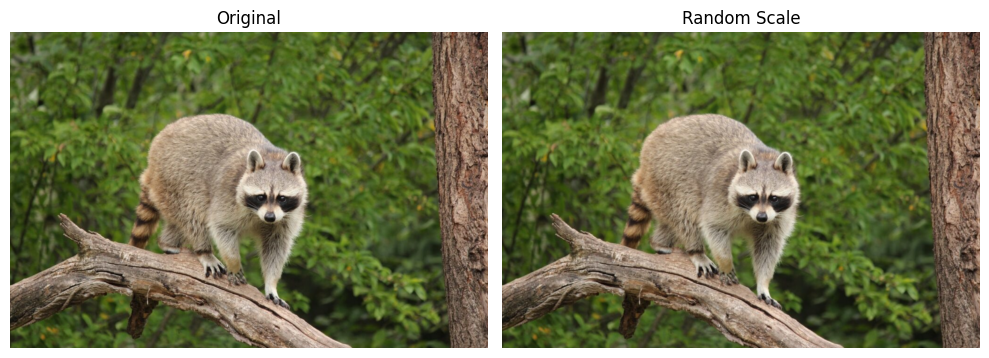

In [ ]:
transform = A.RandomScale(
    scale_limit=0.2,                  # scale randomly between 0.8x and 1.2x
    interpolation=cv2.INTER_LINEAR,
    mask_interpolation=cv2.INTER_NEAREST,
    area_for_downscale="image",
    p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Random Scale"); plt.axis("off")
plt.tight_layout(); plt.show()

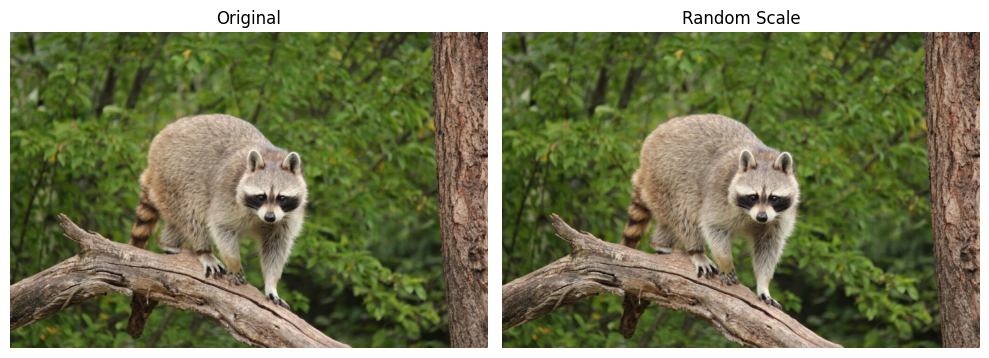

In [ ]:
transform = A.ElasticTransform(
    alpha=1,
    sigma=60,
    p=1.0
)
aug = transform(image=img)["image"]

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1); plt.imshow(img); plt.title("Original"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow(aug); plt.title("Elastic Transform"); plt.axis("off")
plt.tight_layout(); plt.show()

# 3D Transforms

## CenterCrop3D

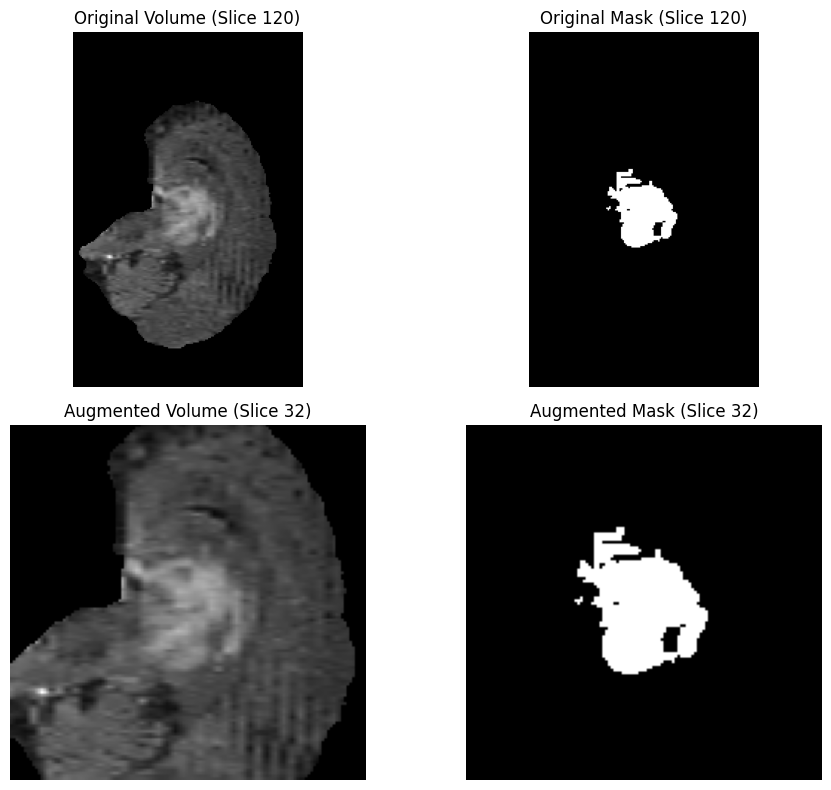

In [ ]:
# Load the 3D MRI volume and mask
volume = nib.load("/content/BraTS20_Training_001_flair.nii").get_fdata().astype("float32")
mask = nib.load("/content/BraTS20_Training_001_seg.nii").get_fdata().astype("uint8")

# Define the CenterCrop3D transform with mask support
transform = A.CenterCrop3D(
    size=(64, 128, 128),  # (depth, height, width)
    pad_if_needed=True,
    fill=0,
    fill_mask=0,
    p=1.0
)

# Apply the transform to both volume and mask
augmented = transform(volume=volume, mask3d=mask)
vol_aug = augmented["volume"]
mask_aug = augmented["mask3d"]

# Display axial slice from the center of the original and augmented volumes
z_orig = volume.shape[0] // 2
z_aug = vol_aug.shape[0] // 2

fig, axs = plt.subplots(2, 2, figsize=(10, 8))

# Original Volume + Mask
axs[0, 0].imshow(volume[z_orig], cmap='gray')
axs[0, 0].set_title("Original Volume (Slice {})".format(z_orig))
axs[0, 0].axis('off')

axs[0, 1].imshow(mask[z_orig], cmap='gray')
axs[0, 1].set_title("Original Mask (Slice {})".format(z_orig))
axs[0, 1].axis('off')

# Augmented Volume + Mask
axs[1, 0].imshow(vol_aug[z_aug], cmap='gray')
axs[1, 0].set_title("Augmented Volume (Slice {})".format(z_aug))
axs[1, 0].axis('off')

axs[1, 1].imshow(mask_aug[z_aug], cmap='gray')
axs[1, 1].set_title("Augmented Mask (Slice {})".format(z_aug))
axs[1, 1].axis('off')

plt.tight_layout()
plt.show()


## CoarseDropout3D

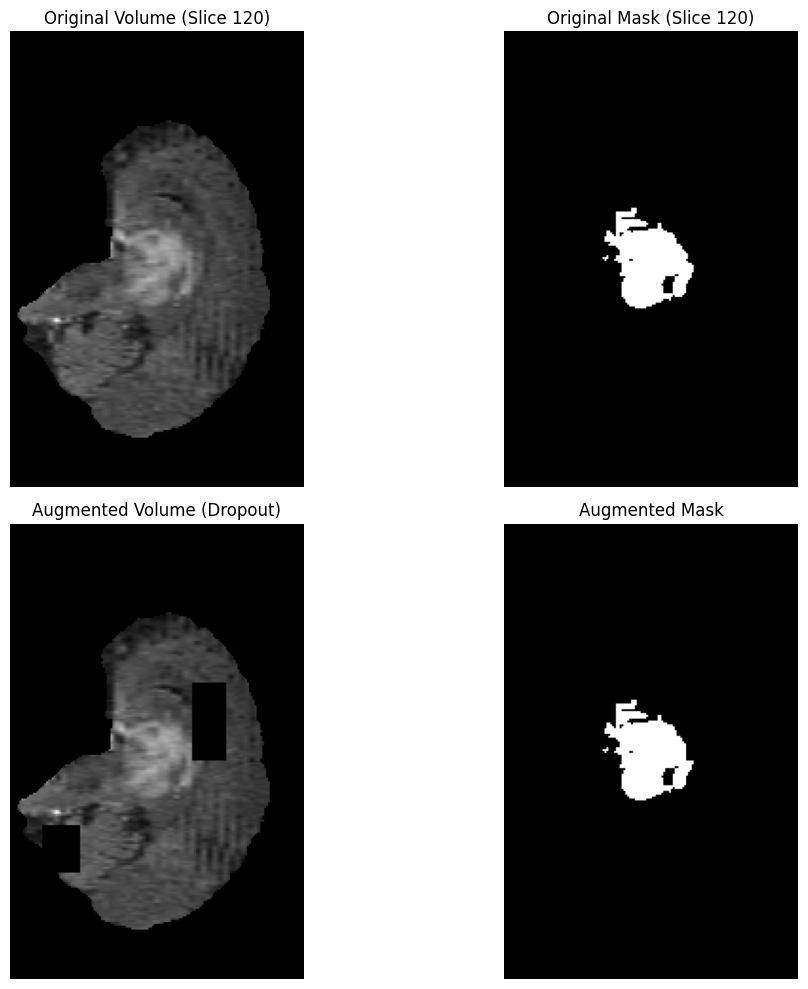

In [ ]:
# Load 3D volume and mask
volume = nib.load("/content/BraTS20_Training_001_flair.nii").get_fdata().astype(np.float32)
mask = nib.load("/content/BraTS20_Training_001_seg.nii").get_fdata().astype(np.uint8)

# Define the CoarseDropout3D transform
transform = A.CoarseDropout3D(
    num_holes_range=(2, 6),
    hole_depth_range=(0.1, 0.2),
    hole_height_range=(0.1, 0.2),
    hole_width_range=(0.1, 0.2),
    p=1.0
)

# Apply the transform to volume and mask
augmented = transform(volume=volume, mask3d=mask)
vol_aug = augmented["volume"]
mask_aug = augmented["mask3d"]

# Visualize a central slice before and after
z = volume.shape[0] // 2
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

axs[0, 0].imshow(volume[z], cmap='gray')
axs[0, 0].set_title("Original Volume (Slice {})".format(z))
axs[0, 0].axis("off")

axs[0, 1].imshow(mask[z], cmap='gray')
axs[0, 1].set_title("Original Mask (Slice {})".format(z))
axs[0, 1].axis("off")

axs[1, 0].imshow(vol_aug[z], cmap='gray')
axs[1, 0].set_title("Augmented Volume (Dropout)")
axs[1, 0].axis("off")

axs[1, 1].imshow(mask_aug[z], cmap='gray')
axs[1, 1].set_title("Augmented Mask")
axs[1, 1].axis("off")

plt.tight_layout()
plt.show()

## Pad3D

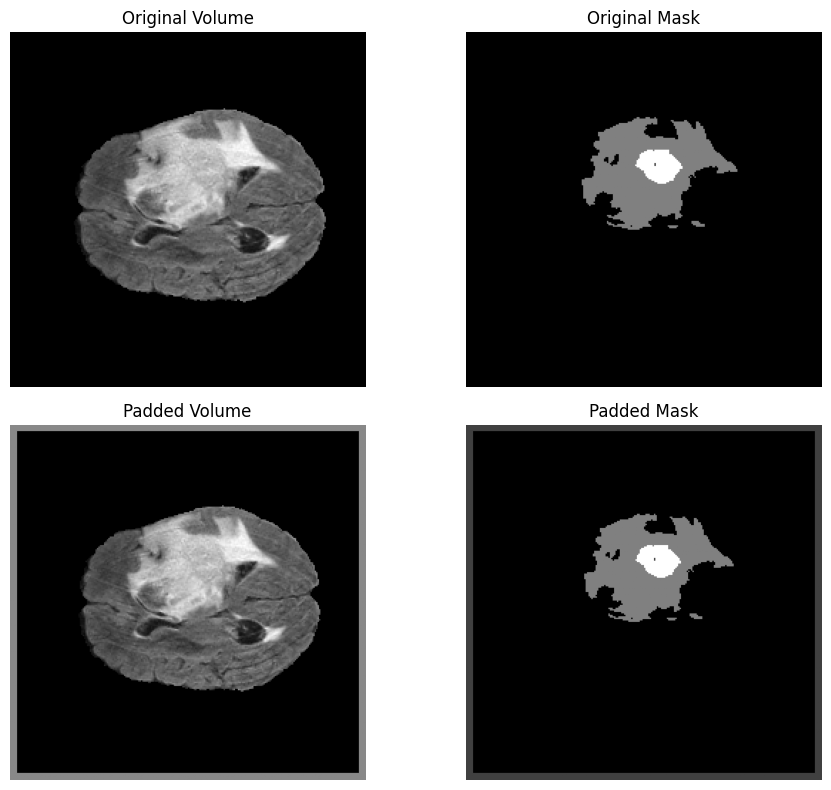

In [ ]:
# Load 3D volume and mask
volume = nib.load("/content/BraTS20_Training_001_flair.nii").get_fdata().astype(np.float32)
mask = nib.load("/content/BraTS20_Training_001_seg.nii").get_fdata().astype(np.uint8)

# Apply Pad3D transformation
transform = A.Pad3D(
    padding=(5, 5, 5),  # Pad depth, height, width by 5 on each side
    fill=225,
    fill_mask=1,
    p=1.0
)

augmented = transform(volume=volume, mask3d=mask)
vol_aug = augmented["volume"]
mask_aug = augmented["mask3d"]


# Pick center slice from both original and padded volumes
z_orig = volume.shape[2] // 2
z_aug = vol_aug.shape[2] // 2

# Plot original and padded images
fig, axs = plt.subplots(2, 2, figsize=(10, 8))
axs[0, 0].imshow(volume[:, :, z_orig], cmap='gray')
axs[0, 0].set_title("Original Volume")
axs[0, 1].imshow(mask[:, :, z_orig], cmap='gray')
axs[0, 1].set_title("Original Mask")
axs[1, 0].imshow(vol_aug[:, :, z_aug], cmap='gray')
axs[1, 0].set_title("Padded Volume")
axs[1, 1].imshow(mask_aug[:, :, z_aug], cmap='gray')
axs[1, 1].set_title("Padded Mask")

for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()

## RandomCrop3D

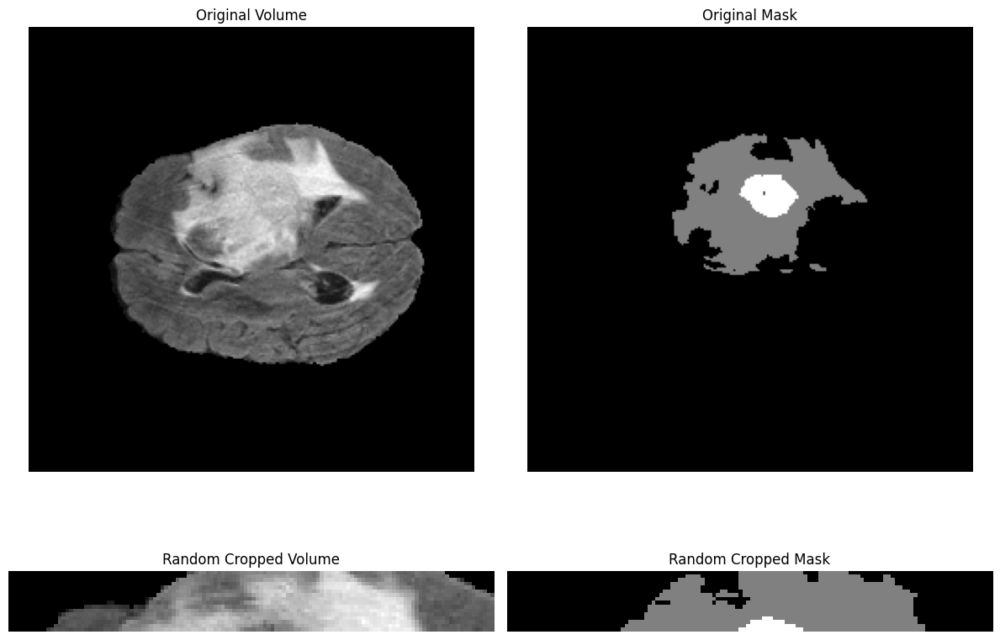

In [ ]:
# Load 3D volume and mask
volume = nib.load("BraTS20_Training_001_flair.nii").get_fdata().astype(np.float32)
mask = nib.load("BraTS20_Training_001_seg.nii").get_fdata().astype(np.uint8)

# Define transform
transform = A.RandomCrop3D(
    size=(16, 128, 128),
    pad_if_needed=True,
    fill=0,
    fill_mask=0,
    p=1.0
)

# Apply transform
augmented = transform(volume=volume, mask3d=mask)
vol_aug = augmented["volume"]
mask_aug = augmented["mask3d"]

# Visualize central slices
z_orig = volume.shape[2] // 2
z_aug = vol_aug.shape[2] // 2

fig, axs = plt.subplots(2, 2, figsize=(12, 10))
axs[0, 0].imshow(volume[:, :, z_orig], cmap='gray')
axs[0, 0].set_title("Original Volume")
axs[0, 1].imshow(mask[:, :, z_orig], cmap='gray')
axs[0, 1].set_title("Original Mask")
axs[1, 0].imshow(vol_aug[:, :, z_aug], cmap='gray')
axs[1, 0].set_title("Random Cropped Volume")
axs[1, 1].imshow(mask_aug[:, :, z_aug], cmap='gray')
axs[1, 1].set_title("Random Cropped Mask")
for ax in axs.flat:
    ax.axis('off')
plt.tight_layout()
plt.show()

# Albumentations Pipeline

## Basic Pipeline Example 1

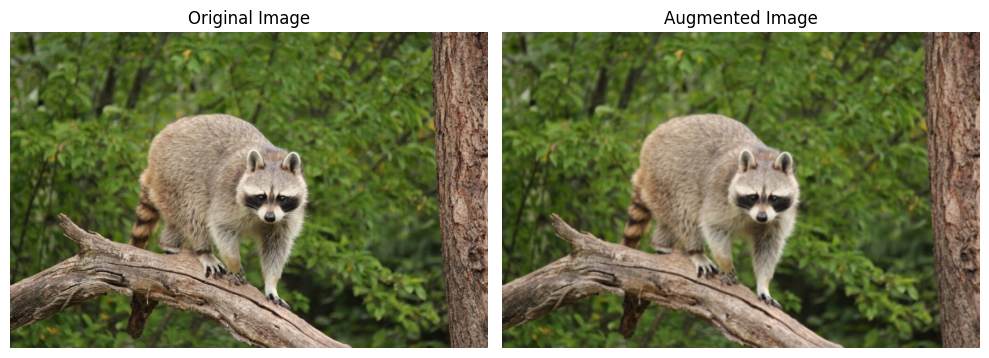

In [3]:
# Load image
image = cv2.imread("raccoon.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Define pipeline
pipeline = A.Compose([
    A.HorizontalFlip(p=0.5),             # 50% chance to flip
    A.RandomBrightnessContrast(p=0.7),   # 70% chance to adjust brightness/contrast
    A.GaussianBlur(p=0.3)                # 30% chance to apply blur
])

# Apply pipeline
result = pipeline(image=image)
aug_image = result["image"]

# Display original and augmented image side by side
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(aug_image)
plt.title("Augmented Image")
plt.axis("off")

plt.tight_layout()
plt.show()


## Basic Pipeline Example 2 - Transform Tracking

Applied Transforms:
- HorizontalFlip with params: {'shape': (843, 1274, 3)}
- RandomBrightnessContrast with params: {'shape': (843, 1274, 3), 'alpha': 0.8721186976418599, 'beta': -38.15060270124681}


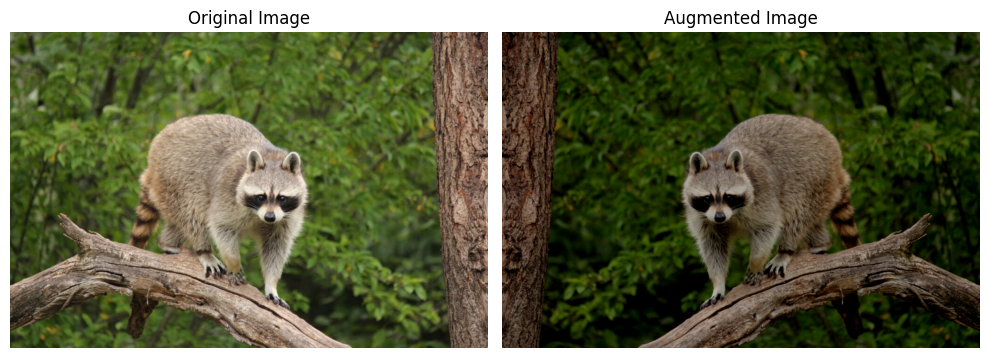

In [6]:
# Define pipeline with applied transform tracking
pipeline = A.Compose([
    A.HorizontalFlip(p=0.5),             # 50% chance to flip
    A.RandomBrightnessContrast(p=0.7),   # 70% chance to adjust brightness/contrast
    A.GaussianBlur(p=0.3)                # 30% chance to apply blur
], save_applied_params=True)

# Apply pipeline
result = pipeline(image=image)
aug_image = result["image"]

# Print which transforms were applied
print("Applied Transforms:")
for transform_name, params in result.get("applied_transforms", []):
    print(f"- {transform_name} with params: {params}")

# Display original and augmented image
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(aug_image)
plt.title("Augmented Image")
plt.axis("off")

plt.tight_layout()
plt.show()


# Albumentations Augmentation Pipeline Examples with Image + Targets

In [ ]:
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 33.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 884.7 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 84.1 MB/s eta 0:00:00


## Bounding box augment


0: 576x640 8 persons, 2 baseball bats, 252.6ms
Speed: 8.3ms preprocess, 252.6ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)


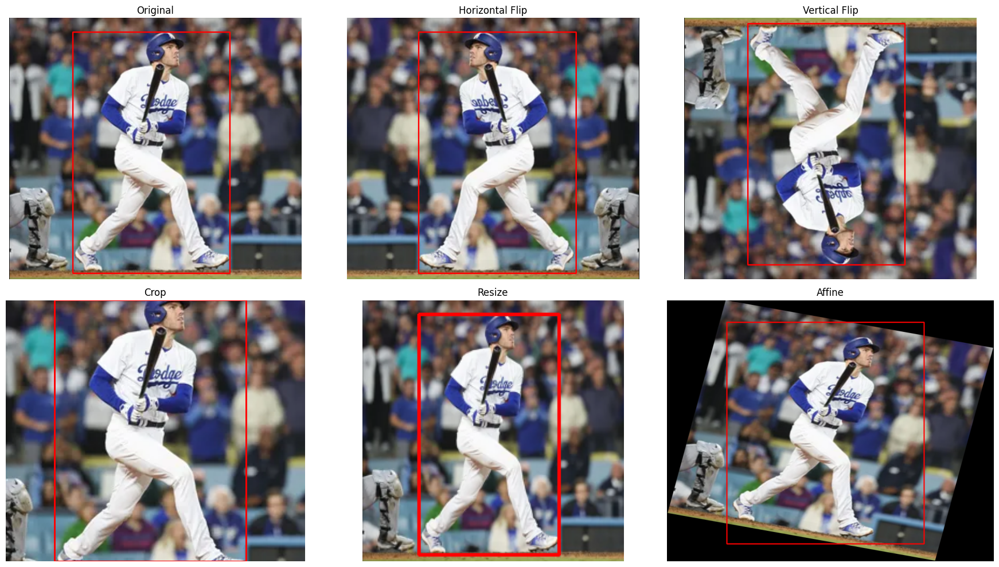

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import albumentations as A

# Load the image
img_path = "baseball.png"
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Load YOLOv8 model and detect people
model = YOLO("yolov8n.pt")
results = model(img)

# Extract 'person' bounding boxes
class_map = model.names
person_id = [k for k, v in class_map.items() if v.lower() == "person"][0]

CONFIDENCE_THRESHOLD = 0.8

bbox_coords = []
class_labels = []
for box in results[0].boxes:
    if int(box.cls) == person_id and float(box.conf) > CONFIDENCE_THRESHOLD:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        bbox_coords.append([x1, y1, x2, y2])
        class_labels.append("person")

# Albumentations bbox parameters
bbox_params = A.BboxParams(format='pascal_voc', label_fields=['class_labels'])

# Define transforms
transforms = {
    "Original": A.Compose([], bbox_params=bbox_params),
    "Horizontal Flip": A.Compose([A.HorizontalFlip(p=1)], bbox_params=bbox_params),
    "Vertical Flip": A.Compose([A.VerticalFlip(p=1)], bbox_params=bbox_params),
    "Crop": A.Compose([A.Crop(x_min=50, y_min=50, x_max=img.shape[1]-50, y_max=img.shape[0]-50, p=1)], bbox_params=bbox_params),
    "Resize": A.Compose([A.Resize(height=224, width=224, p=1)], bbox_params=bbox_params),
    "Affine": A.Compose([
        A.Affine(scale=(0.8, 1.2), rotate=(-30, 30),
                 shear={"x": (-10, 10), "y": (-5, 5)},
                 translate_percent={"x": (-0.1, 0.1), "y": (-0.1, 0.1)},
                 fit_output=True, p=1)], bbox_params=bbox_params)
}

# Draw boxes
def draw_boxes(image, bboxes):
    for x1, y1, x2, y2 in bboxes:
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
    return image

# Visualize
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

for i, (name, transform) in enumerate(transforms.items()):
    augmented = transform(image=img, bboxes=bbox_coords, class_labels=class_labels)
    aug_img = draw_boxes(augmented["image"].copy(), augmented["bboxes"])
    axs[i].imshow(aug_img)
    axs[i].set_title(name)
    axs[i].axis("off")

plt.tight_layout()
plt.show()


## Segmentation mask augment

Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth
100%|██████████| 233M/233M [00:02<00:00, 90.7MB/s]


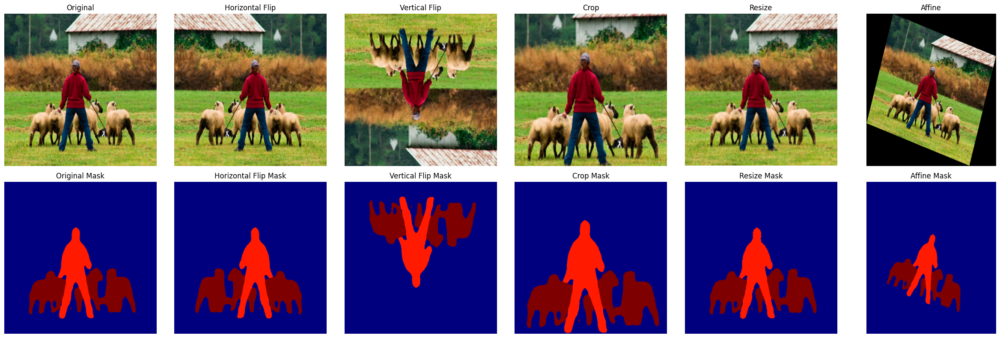

In [3]:
import cv2
import numpy as np
import torch
from torchvision import models, transforms
import albumentations as A
import matplotlib.pyplot as plt

# Load and preprocess image
img_path = "scene.png"
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
input_img = cv2.resize(img, (520, 520))

# Transform for DeepLabV3
preprocess = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((520, 520)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])
input_tensor = preprocess(input_img).unsqueeze(0)

# Load DeepLabV3 model
model = models.segmentation.deeplabv3_resnet101(weights='DEFAULT').eval()

# Run inference
with torch.no_grad():
    output = model(input_tensor)['out'][0]
segmentation_mask = output.argmax(0).byte().cpu().numpy()

# Albumentations transforms
transform_list = {
    "Original": A.Compose([]),
    "Horizontal Flip": A.Compose([A.HorizontalFlip(p=1)]),
    "Vertical Flip": A.Compose([A.VerticalFlip(p=1)]),
    "Crop": A.Compose([A.Crop(x_min=50, y_min=50, x_max=470, y_max=470)]),
    "Resize": A.Compose([A.Resize(height=256, width=256)]),
    "Affine": A.Compose([
        A.Affine(scale=(0.8,1.2), rotate=(-25,25), translate_percent={"x":(-0.1,0.1),"y":(-0.1,0.1)},
                 shear={"x":(-10,10),"y":(-10,10)}, fit_output=True, p=1.0)
    ])
}

# Visualization
n = len(transform_list)
fig, axs = plt.subplots(2, n, figsize=(4 * n, 8))  # 2 rows: image & mask

for i, (name, transform) in enumerate(transform_list.items()):
    augmented = transform(image=input_img, mask=segmentation_mask)
    aug_img = augmented["image"]
    aug_mask = augmented["mask"]

    axs[0, i].imshow(aug_img)
    axs[0, i].set_title(f"{name}")
    axs[0, i].axis("off")

    axs[1, i].imshow(aug_mask, cmap='jet')
    axs[1, i].set_title(f"{name} Mask")
    axs[1, i].axis("off")

plt.tight_layout()
plt.show()


## Keypoint augment

100%|██████████| 6.52M/6.52M [00:00<00:00, 119MB/s]



0: 576x640 4 persons, 395.3ms
Speed: 9.2ms preprocess, 395.3ms inference, 3.2ms postprocess per image at shape (1, 3, 576, 640)


/usr/local/lib/python3.11/dist-packages/albumentations/core/composition.py:331: UserWarning: Got processor for keypoints, but no transform to process it.
  self._set_keys()


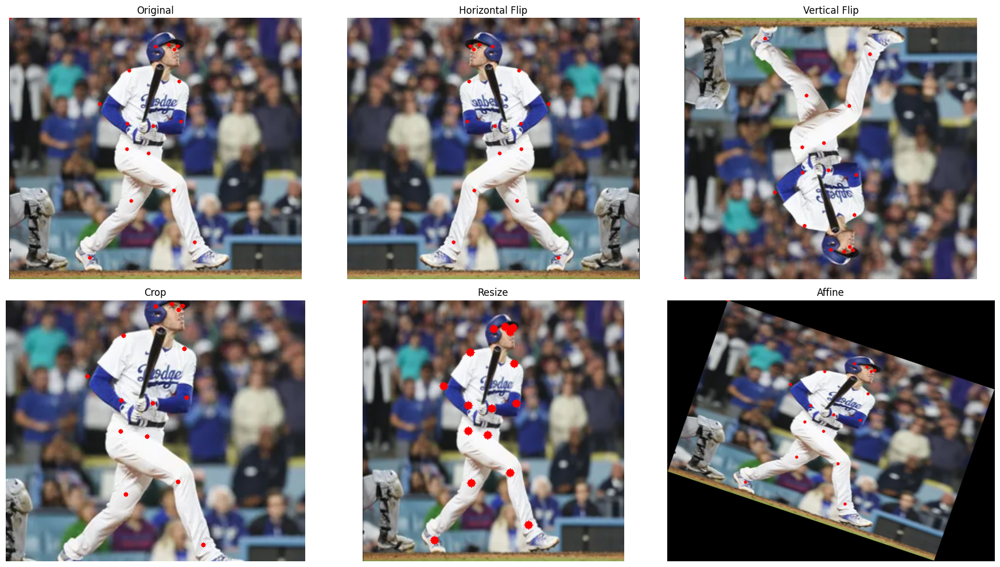

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import albumentations as A

# Load image
img = cv2.imread("baseball.png")  # replace with your pose image
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Load YOLOv8 pose model
model = YOLO("yolov8n-pose.pt")
results = model.predict(img)

# Extract keypoints (list of lists) for the first detected person
# keypoints xy coords: results[0].keypoints.xy (list of shape (num_detections, num_kps, 2))
kps = results[0].keypoints.xy.cpu().tolist()
kps = kps[0]  # pick first person
kps_labels = ["kp"] * len(kps)

# Albumentations keypoints handler
kp_params = A.KeypointParams(format='xy', label_fields=['kps_labels'])

# Define augmentations
augments = {
    "Original": A.Compose([], keypoint_params=kp_params),
    "Horizontal Flip": A.Compose([A.HorizontalFlip(p=1.0)], keypoint_params=kp_params),
    "Vertical Flip": A.Compose([A.VerticalFlip(p=1.0)], keypoint_params=kp_params),
    "Crop": A.Compose([A.Crop(x_min=50, y_min=50, x_max=img.shape[1]-50, y_max=img.shape[0]-50, p=1.0)], keypoint_params=kp_params),
    "Resize": A.Compose([A.Resize(256, 256, p=1.0)], keypoint_params=kp_params),
    "Affine": A.Compose([
        A.Affine(scale=(0.8,1.2), rotate=(-25,25), translate_percent={"x":(-0.1,0.1),"y":(-0.1,0.1)},
                 shear={"x":(-10,10),"y":(-10,10)}, fit_output=True, p=1.0)
    ], keypoint_params=kp_params),
}

# Helper to draw keypoints
def draw_kps(img, keypoints):
    out = img.copy()
    for x, y in keypoints:
        cv2.circle(out, (int(x), int(y)), 4, (255, 0, 0), -1)
    return out

# Visualize
fig, axs = plt.subplots(2, 3, figsize=(18, 10))
axs = axs.flatten()

for i, (name, aug) in enumerate(augments.items()):
    res = aug(image=img, keypoints=kps, kps_labels=kps_labels)
    out_img = draw_kps(res["image"], res["keypoints"])
    axs[i].imshow(out_img)
    axs[i].set_title(name)
    axs[i].axis("off")

plt.tight_layout()
plt.show()


# Video Augmentation

In [ ]:
# STEP 2: Import libraries
import os
import cv2
import numpy as np
from tqdm import tqdm
from ultralytics import YOLO
import albumentations as A
from google.colab import files

# STEP 3: Upload video file
uploaded = files.upload()
video_path = list(uploaded.keys())[0]

# STEP 4: Setup directories
os.makedirs("frames", exist_ok=True)
os.makedirs("labels", exist_ok=True)
os.makedirs("augmented_frames", exist_ok=True)
os.makedirs("augmented_labels", exist_ok=True)

# Load YOLO model (for detecting "car")
model = YOLO("yolov8n.pt")
class_map = model.names
car_class_ids = [k for k, v in class_map.items() if v.lower() == "car"]

# STEP 5: Read video and run YOLO
cap = cv2.VideoCapture(video_path)
frame_w = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_h = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

video_frames = []
all_bboxes = []
class_labels = []
frame_indices = []

frame_idx = 0
print("Detecting and saving original frames and labels...")
while True:
    ret, frame = cap.read()
    if not ret:
        break

    video_frames.append(frame)
    results = model(frame)[0]

    # Save original frame
    cv2.imwrite(f"frames/frame_{frame_idx:05d}.jpg", frame)

    # Save YOLO label file for current frame
    with open(f"labels/frame_{frame_idx:05d}.txt", "w") as f:
        for box in results.boxes:
            cls_id = int(box.cls.item())
            if cls_id in car_class_ids:
                x1, y1, x2, y2 = map(float, box.xyxy[0])
                cx = (x1 + x2) / 2 / frame_w
                cy = (y1 + y2) / 2 / frame_h
                bw = (x2 - x1) / frame_w
                bh = (y2 - y1) / frame_h

                # Write to original label file
                f.write(f"{cls_id} {cx:.6f} {cy:.6f} {bw:.6f} {bh:.6f}\n")

                # Save for augmentation
                all_bboxes.append([cx, cy, bw, bh])
                class_labels.append(cls_id)
                frame_indices.append(frame_idx)

    frame_idx += 1

cap.release()
video_array = np.array(video_frames)
print(f"Total frames: {len(video_array)}, Total boxes: {len(all_bboxes)}")

# STEP 6: Define video-consistent Albumentations transform
transform = A.Compose([
    A.HorizontalFlip(p=1.0),
    A.RandomBrightnessContrast(p=1.0),
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels', 'frame_indices']))


# STEP 7: Apply the augmentation consistently across all frames
print("Applying video-consistent augmentation...")
aug = transform(
    images=video_array,
    bboxes=all_bboxes,
    class_labels=class_labels,
    frame_indices=frame_indices
)

aug_images = aug['images']
aug_bboxes = np.array(aug['bboxes'])
aug_class_labels = np.array(aug['class_labels'])
aug_frame_indices = np.array(aug['frame_indices'])

print("Augmentation complete.")

# STEP 8: Regroup and save augmented frames and labels
print("Saving augmented frames and labels...")
for i in range(len(aug_images)):
    cv2.imwrite(f"augmented_frames/frame_{i:05d}.jpg", aug_images[i])

for idx in range(len(aug_images)):
    mask = aug_frame_indices == idx
    boxes = aug_bboxes[mask]
    labels = aug_class_labels[mask]

    with open(f"augmented_labels/frame_{idx:05d}.txt", "w") as f:
        for (cx, cy, bw, bh), cls in zip(boxes, labels):
            f.write(f"{cls} {cx:.6f} {cy:.6f} {bw:.6f} {bh:.6f}\n")

print("All done! Outputs saved to:")
print("frames/ and labels/ (original)")
print("augmented_frames/ and augmented_labels/ (augmented)")


Saving car_race.mp4 to car_race.mp4
Detecting and saving original frames and labels...

0: 384x640 1 car, 281.8ms
Speed: 6.0ms preprocess, 281.8ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 truck, 242.3ms
Speed: 3.7ms preprocess, 242.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 1 truck, 251.0ms
Speed: 4.7ms preprocess, 251.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 199.6ms
Speed: 2.6ms preprocess, 199.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 161.1ms
Speed: 2.6ms preprocess, 161.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 1 truck, 156.4ms
Speed: 2.4ms preprocess, 156.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 truck, 158.9ms
Speed: 2.6ms preprocess, 158.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 ca

In [ ]:
# === Define parameters
frame_dir_input = "frames"
label_dir_input = "labels"
frame_dir_aug = "augmented_frames"
label_dir_aug = "augmented_labels"

output_video_input = "original_with_boxes.mp4"
output_video_aug = "augmented_with_boxes.mp4"

# Get frame size from a sample frame
sample_frame = cv2.imread(os.path.join(frame_dir_aug, "frame_00000.jpg"))
height, width = sample_frame.shape[:2]

# Define video writers
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer_input = cv2.VideoWriter(output_video_input, fourcc, 30, (width, height))
video_writer_aug = cv2.VideoWriter(output_video_aug, fourcc, 30, (width, height))

# === Helper function with class name support
def draw_boxes(image, label_path, color=(0, 255, 0)):
    h, w = image.shape[:2]
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                cls_id, cx, cy, bw, bh = map(float, line.strip().split())
                x1 = int((cx - bw / 2) * w)
                y1 = int((cy - bh / 2) * h)
                x2 = int((cx + bw / 2) * w)
                y2 = int((cy + bh / 2) * h)
                class_name = class_map.get(int(cls_id), f"Class {int(cls_id)}")
                cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
                cv2.putText(image, class_name, (x1, y1 - 5),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return image

# === STEP 4A: Write original video with bounding boxes and class names
print("Creating original_with_boxes.mp4...")
num_input_frames = len(sorted(os.listdir(frame_dir_input)))
for i in range(num_input_frames):
    frame_path = os.path.join(frame_dir_input, f"frame_{i:05d}.jpg")
    label_path = os.path.join(label_dir_input, f"frame_{i:05d}.txt")
    frame = cv2.imread(frame_path)
    frame = draw_boxes(frame, label_path, color=(0, 255, 0))
    video_writer_input.write(frame)
video_writer_input.release()

# === STEP 4B: Write augmented video with bounding boxes and class names
print("Creating augmented_with_boxes.mp4...")
num_aug_frames = len(sorted(os.listdir(frame_dir_aug)))
for i in range(num_aug_frames):
    frame_path = os.path.join(frame_dir_aug, f"frame_{i:05d}.jpg")
    label_path = os.path.join(label_dir_aug, f"frame_{i:05d}.txt")
    frame = cv2.imread(frame_path)
    frame = draw_boxes(frame, label_path, color=(0, 0, 255))
    video_writer_aug.write(frame)
video_writer_aug.release()

print("Videos saved as:")
print("→ original_with_boxes.mp4")
print("→ augmented_with_boxes.mp4")

Creating original_with_boxes.mp4...
Creating augmented_with_boxes.mp4...
Videos saved as:
→ original_with_boxes.mp4
→ augmented_with_boxes.mp4


# Benchmark

In [ ]:
!pip install kornia --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 29.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 91.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 75.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 68.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 95.6 MB/s eta 0:00:00


Using device: cuda

Benchmarking transforms (10 iterations each):
------------------------------------------------------------

Testing HorizontalFlip:
  Torchvision: 0.0167±0.0019s
  Albumentations: 0.0027±0.0004s
  Kornia (CPU): 0.0605±0.0009s
  Kornia (GPU): 0.0496±0.0005s

Testing VerticalFlip:
  Torchvision: 0.0147±0.0003s
  Albumentations: 0.0026±0.0003s
  Kornia (CPU): 0.0595±0.0012s
  Kornia (GPU): 0.0484±0.0005s

Testing Rotation:
  Torchvision: 0.0440±0.0065s
  Albumentations: 0.0415±0.0016s
  Kornia (CPU): 0.2225±0.0205s
  Kornia (GPU): 0.0853±0.0141s

Testing ColorJitter:
  Torchvision: 0.7792±0.1620s
  Albumentations: 0.0606±0.0057s
  Kornia (CPU): 1.5846±0.0667s
  Kornia (GPU): 0.1436±0.0144s

Testing Brightness:
  Torchvision: 0.0794±0.0013s
  Albumentations: 0.0088±0.0013s
  Kornia (CPU): 0.1082±0.0015s
  Kornia (GPU): 0.1022±0.0174s

Testing Contrast:
  Torchvision: 0.0903±0.0066s
  Albumentations: 0.0083±0.0001s
  Kornia (CPU): 0.1087±0.0023s
  Kornia (GPU): 0.1231±0.

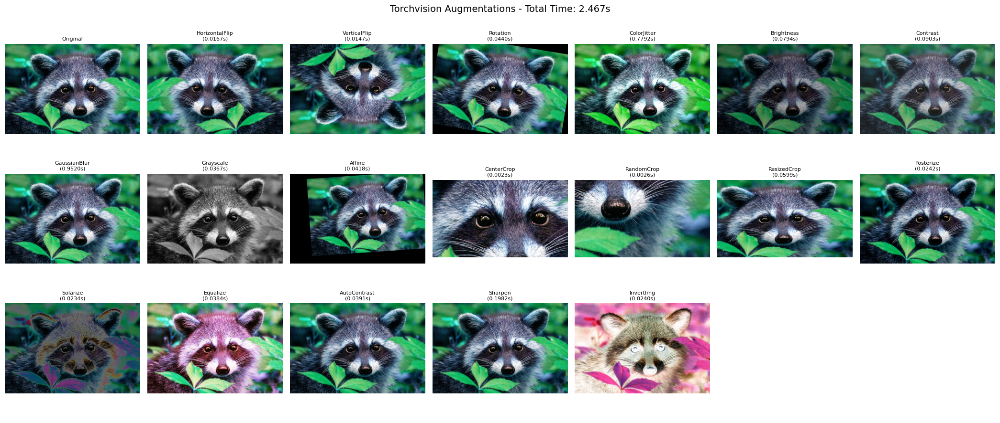

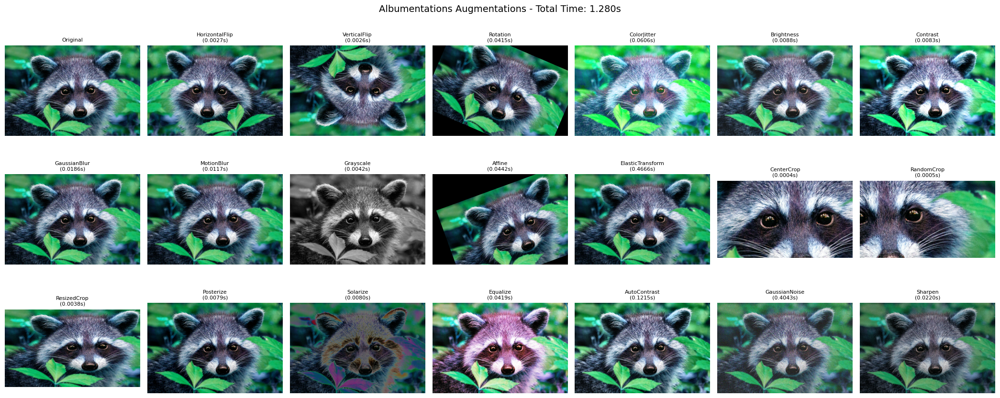

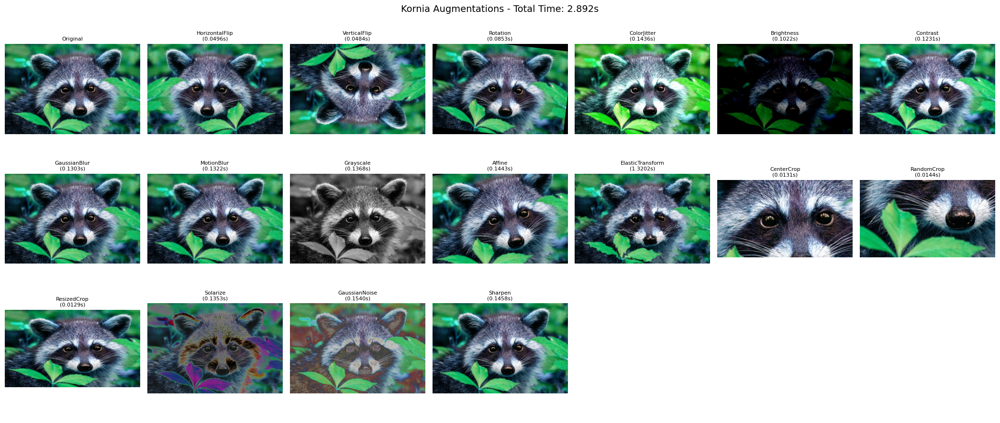

In [ ]:
import time
import numpy as np
import cv2
import torch
from torchvision import transforms as T
from PIL import Image
import albumentations as A
import kornia.augmentation as K
import matplotlib.pyplot as plt

def benchmark_transform(transform_func, iterations=10):
    """Benchmark a transform with multiple iterations"""
    times = []
    for _ in range(iterations):
        start = time.time()
        result = transform_func()
        end = time.time()
        times.append(end - start)

    # Remove outliers (first run often slower due to initialization)
    times = sorted(times)[1:-1] if len(times) > 3 else times
    return np.mean(times), np.std(times)

# load test image
image_np = cv2.imread("raccoon3000x2000.jpg", cv2.COLOR_BGR2RGB)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Prepare images for each library
image_pil = Image.fromarray(image_np)
image_tensor = torch.tensor(image_np / 255.0, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)

# ---------------- Equivalent Transforms ----------------
equivalent_transforms = [
    {
        "name": "HorizontalFlip",
        "torchvision": T.RandomHorizontalFlip(p=1.0),
        "albumentations": A.HorizontalFlip(p=1.0),
        "kornia": K.RandomHorizontalFlip(p=1.0)
    },
    {
        "name": "VerticalFlip",
        "torchvision": T.RandomVerticalFlip(p=1.0),
        "albumentations": A.VerticalFlip(p=1.0),
        "kornia": K.RandomVerticalFlip(p=1.0)
    },
    {
        "name": "Rotation",
        "torchvision": T.RandomRotation(30),
        "albumentations": A.Rotate(limit=30, p=1.0),
        "kornia": K.RandomRotation(degrees=30.0, p=1.0)
    },
    {
        "name": "ColorJitter",
        "torchvision": T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
        "albumentations": A.HueSaturationValue(hue_shift_limit=18, sat_shift_limit=77, val_shift_limit=77, p=1.0),
        "kornia": K.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1, p=1.0)
    },
    {
        "name": "Brightness",
        "torchvision": T.ColorJitter(brightness=0.5),
        "albumentations": A.RandomBrightnessContrast(brightness_limit=0.5, contrast_limit=0, p=1.0),
        "kornia": K.RandomBrightness(brightness=(0.5, 1.5), p=1.0)
    },
    {
        "name": "Contrast",
        "torchvision": T.ColorJitter(contrast=0.5),
        "albumentations": A.RandomBrightnessContrast(brightness_limit=0, contrast_limit=0.5, p=1.0),
        "kornia": K.RandomContrast(contrast=(0.5, 1.5), p=1.0)
    },
    {
        "name": "GaussianBlur",
        "torchvision": T.GaussianBlur(kernel_size=5, sigma=1.0),
        "albumentations": A.GaussianBlur(blur_limit=(5, 5), sigma_limit=(1.0, 1.0), p=1.0),
        "kornia": K.RandomGaussianBlur((5, 5), (1.0, 1.0), p=1.0)
    },
    {
        "name": "MotionBlur",
        "torchvision": None,  # Not available in torchvision
        "albumentations": A.MotionBlur(blur_limit=7, p=1.0),
        "kornia": K.RandomMotionBlur(kernel_size=7, angle=45.0, direction=0.5, p=1.0)
    },
    {
        "name": "Grayscale",
        "torchvision": T.RandomGrayscale(p=1.0),
        "albumentations": A.ToGray(p=1.0),
        "kornia": K.RandomGrayscale(p=1.0)
    },
    {
        "name": "Affine",
        "torchvision": T.RandomAffine(degrees=20, translate=(0.1, 0.1), scale=(0.8, 1.2)),
        "albumentations": A.Affine(translate_percent=0.1, scale=(0.8, 1.2), rotate=20, p=1.0),
        "kornia": K.RandomAffine(degrees=20.0, translate=(0.1, 0.1), scale=(0.8, 1.2), p=1.0)
    },
    {
        "name": "ElasticTransform",
        "torchvision": None,  # Not available in torchvision
        "albumentations": A.ElasticTransform(alpha=50, sigma=5, p=1.0),
        "kornia": K.RandomElasticTransform(kernel_size=(63, 63), sigma=(32.0, 32.0), alpha=(1.0, 1.0), p=1.0)
    },
    {
        "name": "CenterCrop",
        "torchvision": T.CenterCrop((800, 1400)),
        "albumentations": A.CenterCrop(height=800, width=1400, p=1.0),
        "kornia": K.CenterCrop((800, 1400), p=1.0)
    },
    {
        "name": "RandomCrop",
        "torchvision": T.RandomCrop((800, 1400)),
        "albumentations": A.RandomCrop(height=800, width=1400, p=1.0),
        "kornia": K.RandomCrop((800, 1400), p=1.0)
    },
    {
        "name": "ResizedCrop",
        "torchvision": T.RandomResizedCrop((800, 1400), scale=(0.7, 1.0)),
        "albumentations": A.RandomResizedCrop(size=(800, 1400), scale=(0.7, 1.0), p=1.0),
        "kornia": K.RandomResizedCrop((800, 1400), scale=(0.7, 1.0), p=1.0)
    },
    {
        "name": "Posterize",
        "torchvision": T.RandomPosterize(bits=4, p=1.0),
        "albumentations": A.Posterize(num_bits=4, p=1.0),
        "kornia": None  # Not available in kornia
    },
    {
        "name": "Solarize",
        "torchvision": T.RandomSolarize(threshold=128, p=1.0),
        "albumentations": A.Solarize(threshold_range=(0.3, 0.7), p=1.0),
        "kornia": K.RandomSolarize(thresholds=0.5, additions=0.1, p=1.0)
    },
    {
        "name": "Equalize",
        "torchvision": T.RandomEqualize(p=1.0),
        "albumentations": A.Equalize(p=1.0),
        "kornia": None  # Not available in kornia
    },
    {
        "name": "AutoContrast",
        "torchvision": T.RandomAutocontrast(p=1.0),
        "albumentations": A.CLAHE(clip_limit=2.0, tile_grid_size=(8, 8), p=1.0),
        "kornia": None  # Not available in kornia
    },
    {
        "name": "GaussianNoise",
        "torchvision": None,  # Not available in torchvision
        "albumentations": A.GaussNoise(std_range=(0.2, 0.5), p=1.0),
        "kornia": K.RandomGaussianNoise(mean=0.0, std=0.1, p=1.0)
    },
    {
        "name": "Sharpen",
        "torchvision": T.RandomAdjustSharpness(sharpness_factor=2.0, p=1.0),
        "albumentations": A.Sharpen(alpha=(0.2, 0.5), lightness=(0.5, 1.0), p=1.0),
        "kornia": K.RandomSharpness(sharpness=0.5, p=1.0)
    },
    {
        "name": "Emboss",
        "torchvision": None,  # Not available in torchvision
        "albumentations": A.Emboss(alpha=(0.2, 0.5), strength=(0.2, 0.7), p=1.0),
        "kornia": None  # Not available in kornia
    },
    {
        "name": "ChannelShuffle",
        "torchvision": None,  # Not available in torchvision
        "albumentations": A.ChannelShuffle(p=1.0),
        "kornia": None  # Not available in kornia
    },
    {
        "name": "InvertImg",
        "torchvision": T.RandomInvert(p=1.0),
        "albumentations": A.InvertImg(p=1.0),
        "kornia": None  # Not available in kornia
    }
]

# ---------------- Benchmarking ----------------
results = {
    "torchvision": {},
    "albumentations": {},
    "kornia_cpu": {},
    "kornia_gpu": {} if device.type == "cuda" else None
}

visual_results = {
    "torchvision": [("Original", image_np)],
    "albumentations": [("Original", image_np)],
    "kornia": [("Original", image_np)]
}

print("\nBenchmarking transforms (10 iterations each):")
print("-" * 60)

for transform_config in equivalent_transforms:
    name = transform_config["name"]
    print(f"\nTesting {name}:")

    # Torchvision
    if transform_config["torchvision"] is not None:
        try:
            def torchvision_func():
                return np.array(transform_config["torchvision"](image_pil))

            mean_time, std_time = benchmark_transform(torchvision_func)
            results["torchvision"][name] = mean_time
            visual_results["torchvision"].append((f"{name}\n({mean_time:.4f}s)", torchvision_func()))
            print(f"  Torchvision: {mean_time:.4f}±{std_time:.4f}s")
        except Exception as e:
            print(f"  Torchvision: Error - {str(e)[:50]}...")
            results["torchvision"][name] = None
    else:
        print(f"  Torchvision: Not available")
        results["torchvision"][name] = None

    # Albumentations
    if transform_config["albumentations"] is not None:
        try:
            def albumentations_func():
                return transform_config["albumentations"](image=image_np)["image"]

            mean_time, std_time = benchmark_transform(albumentations_func)
            results["albumentations"][name] = mean_time
            visual_results["albumentations"].append((f"{name}\n({mean_time:.4f}s)", albumentations_func()))
            print(f"  Albumentations: {mean_time:.4f}±{std_time:.4f}s")
        except Exception as e:
            print(f"  Albumentations: Error - {str(e)[:50]}...")
            results["albumentations"][name] = None
    else:
        print(f"  Albumentations: Not available")
        results["albumentations"][name] = None

    # Kornia
    if transform_config["kornia"] is not None:
        try:
            kornia_transform = transform_config["kornia"]
            image_tensor_cpu = image_tensor.cpu()

            def kornia_cpu_func():
                with torch.no_grad():
                    result = kornia_transform(image_tensor_cpu)
                    return (result.squeeze().permute(1, 2, 0).numpy() * 255).astype(np.uint8)

            mean_time, std_time = benchmark_transform(kornia_cpu_func)
            results["kornia_cpu"][name] = mean_time
            print(f"  Kornia (CPU): {mean_time:.4f}±{std_time:.4f}s")

            # Kornia GPU (if available)
            if device.type == "cuda":
                image_tensor_gpu = image_tensor.to(device)
                kornia_transform_gpu = kornia_transform.to(device)

                def kornia_gpu_func():
                    with torch.no_grad():
                        torch.cuda.synchronize()
                        result = kornia_transform_gpu(image_tensor_gpu)
                        torch.cuda.synchronize()
                        return (result.squeeze().permute(1, 2, 0).cpu().numpy() * 255).astype(np.uint8)

                mean_time, std_time = benchmark_transform(kornia_gpu_func)
                results["kornia_gpu"][name] = mean_time
                print(f"  Kornia (GPU): {mean_time:.4f}±{std_time:.4f}s")

                # Use GPU version for visual results
                visual_results["kornia"].append((f"{name}\n({mean_time:.4f}s)", kornia_gpu_func()))
            else:
                visual_results["kornia"].append((f"{name}\n({mean_time:.4f}s)", kornia_cpu_func()))

        except Exception as e:
            print(f"  Kornia: Error - {str(e)[:50]}...")
            results["kornia_cpu"][name] = None
            if results["kornia_gpu"] is not None:
                results["kornia_gpu"][name] = None
    else:
        print(f"  Kornia: Not available")
        results["kornia_cpu"][name] = None
        if results["kornia_gpu"] is not None:
            results["kornia_gpu"][name] = None

# ---------------- Summary ----------------
print("\n" + "="*60)
print("PERFORMANCE SUMMARY")
print("="*60)

# Calculate available transforms per library
available_counts = {
    "Torchvision": sum(1 for t in equivalent_transforms if t["torchvision"] is not None),
    "Albumentations": sum(1 for t in equivalent_transforms if t["albumentations"] is not None),
    "Kornia": sum(1 for t in equivalent_transforms if t["kornia"] is not None)
}

print(f"\nTransform Availability:")
for lib, count in available_counts.items():
    print(f"  {lib}: {count}/{len(equivalent_transforms)} transforms available")

# Performance comparison for available transforms
print(f"\nPerformance Comparison (only available transforms):")
print("-" * 60)

for transform_config in equivalent_transforms:
    name = transform_config["name"]
    print(f"\n{name}:")

    times = []
    if results["torchvision"].get(name) is not None:
        times.append(("Torchvision", results["torchvision"][name]))
    if results["albumentations"].get(name) is not None:
        times.append(("Albumentations", results["albumentations"][name]))
    if results["kornia_cpu"].get(name) is not None:
        times.append(("Kornia (CPU)", results["kornia_cpu"][name]))
    if results["kornia_gpu"] and results["kornia_gpu"].get(name) is not None:
        times.append(("Kornia (GPU)", results["kornia_gpu"][name]))

    if times:
        times.sort(key=lambda x: x[1])
        for i, (lib, time_val) in enumerate(times, 1):
            speedup = times[0][1] / time_val if time_val > 0 else 0
            print(f"  {i}. {lib:15s}: {time_val:.4f}s (x{speedup:.2f})")
    else:
        print("  No implementations available")

# Overall library performance
print(f"\n" + "="*60)
print("OVERALL LIBRARY PERFORMANCE")
print("="*60)

library_stats = {}
for lib_key, lib_name in [("torchvision", "Torchvision"), ("albumentations", "Albumentations"),
                         ("kornia_cpu", "Kornia (CPU)"), ("kornia_gpu", "Kornia (GPU)")]:
    if results[lib_key] is not None:
        valid_times = [t for t in results[lib_key].values() if t is not None]
        if valid_times:
            library_stats[lib_name] = {
                "count": len(valid_times),
                "total_time": sum(valid_times),
                "avg_time": np.mean(valid_times),
                "median_time": np.median(valid_times)
            }

for lib_name, stats in sorted(library_stats.items(), key=lambda x: x[1]["avg_time"]):
    print(f"\n{lib_name}:")
    print(f"  Available transforms: {stats['count']}")
    print(f"  Total time: {stats['total_time']:.4f}s")
    print(f"  Average time per transform: {stats['avg_time']:.4f}s")
    print(f"  Median time per transform: {stats['median_time']:.4f}s")

# ---------------- Plotting Function ----------------
def plot_augmented_images(results, title):
    n_images = len(results)
    if n_images <= 1:
        return

    # Limit to first 20 images for reasonable display
    results = results[:21] if n_images > 21 else results
    n_images = len(results)

    cols = min(7, n_images)
    rows = (n_images + cols - 1) // cols

    fig, axs = plt.subplots(rows, cols, figsize=(3*cols, 3*rows))
    if rows == 1:
        axs = [axs] if cols == 1 else axs
    else:
        axs = axs.flatten()

    total_time = sum(float(name.split('(')[-1][:-2]) for name, _ in results[1:] if '(' in name and 's)' in name)
    fig.suptitle(f"{title} - Total Time: {total_time:.3f}s", fontsize=14)

    for i, (name, img) in enumerate(results):
        if i < len(axs):
            axs[i].imshow(img)
            axs[i].set_title(name, fontsize=8)
            axs[i].axis("off")

    for i in range(len(results), len(axs)):
        axs[i].axis("off")

    plt.tight_layout()
    plt.show()

# ---------------- Display Results ----------------
if len(visual_results["torchvision"]) > 1:
    plot_augmented_images(visual_results["torchvision"], "Torchvision Augmentations")

if len(visual_results["albumentations"]) > 1:
    plot_augmented_images(visual_results["albumentations"], "Albumentations Augmentations")

if len(visual_results["kornia"]) > 1:
    plot_augmented_images(visual_results["kornia"], "Kornia Augmentations")